In [73]:
%pylab inline

import numpy as np
# initial states: [x0, y0, z0, ψ, dx0, dy0, dz0, dψ0]
init_state = [0, 0, 0, 0, 0, 0, 0, 0]
# inertia
I = 0.5 / 4
# mass
m = 0.1
# wings angle 
α = pi/6
# Do we want constains?
en_constrain = True
# simulation time
time_out = 120
tf = time_out
dt = 0.05   # Time step
test_time = linspace(0.,time_out, int(tf / dt) )  # Time interval
print(len(test_time))
# number of motors
n = 2
# position of the thrusters
d = 0.6
p = np.array([[-d, 0, 0], [d, 0, 0]]).T
# tilting angles of the propellers
#α = [-pi/2, pi/2]


# assert np.linalg.matrix_rank(A) == 3
# gravity acceleration
g = 9.8
# max force of a propeller
fM = 0.8
# minimum force of a propeller
fm = 0.01
# desired state
des_state = np.array([0., 0., 0., 0., 0., 0., 0., 0.])
# waypoints
waypoints = [[-2.5, 1.5, 2.5], [0, 1.5, 2.5], [0, -1,2.5], [-2.5, -1, 2.5],[-2.5, 1.5, 2.5]]

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib
2400


/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/IPython/core/magics/pylab.py:162: UserWarning: pylab import has clobbered these variables: ['step']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [74]:

Kx = 0.2
Ky = 0.2
Kz = 0.1 / 5 # K for lifting
fe = -0.01  # f effective
Kdrag = 0.5 / 5
# simulate the air pressure with Z value
K_air = 0.001
# step function for the motion of the s_blimp
def step(state, u):
    x, y, z, ψ, dx, dy, dz, dψ = state
    f1,f2 = u
    
    # accelerations 
    ax = Kx * ((f2 - f1) / m ) * sin(ψ) - Kdrag * 2 * dx 
    ay = Ky * ((f2 - f1) / m ) * cos(ψ) - Kdrag * 2 * dy 
    aψ = (d * (f1 + f2) / I - Kdrag  * dψ*dψ)
    az = Kz * sin(α) * dψ * dψ + fe/m -Kdrag*10 * dz 
    
    dx += ax * dt
    dy += ay * dt
    dz += az * dt
    dψ += aψ * dt
    
    x += dx * dt
    y += dy * dt
    z += dz * dt
    ψ += dψ * dt
    if z < 0:
        z = 0
    new_state = np.array([x, y, z, ψ, dx, dy, dz, dψ])
    return new_state

In [81]:
Kpxy = 0.3
Kpy = 0.1
Kpz = 0.1 * 5
Kdxy = 0.1
Kdy = 0.5
Kdz = 0.01 * 20
Kmove = 0.05 / 5
Iz = 0
# testing force u_log
u_log = [[0,0]]

def control(state, des_state, en_constrain):
    x, y, z, ψ, dx, dy, dz, dψ = state[0:9]
    err = des_state - state
    
#     err_pos = np.array([des_state[0] - state[0],des_state[1] - state[1],des_state[2] - state[2]])
    err_pos = err[0:3]
    err_vel = err[4:7]
    
    f_pos = Kpxy*(err_pos)
    
    f_vel = Kdxy*(err_vel)
    hw = Kpz * err_pos[2]
    tau = 0.25
    u = [0,0]
    
    #KD control
#     u[0] = Kpz * (err_pos[2] ) - Kmove * (sin(ψ) * err_pos[0] + cos(ψ) * err_pos[1])
#     u[1] = Kpz * (err_pos[2] ) + Kmove * (sin(ψ) * err_pos[0] + cos(ψ) * err_pos[1])
#     u[0] = Kpz * (err_pos[2] ) - Kdz * err_vel[2] + Kmove * (-sin(ψ) * err_pos[0] - cos(ψ) * err_pos[1])
#     u[1] = Kpz * (err_pos[2] ) - Kdz * err_vel[2] - Kmove * (-sin(ψ) * err_pos[0] - cos(ψ) * err_pos[1])
    # Bangbang control
    print(err_pos)
    theta = np.arctan2(err_pos[1],err_pos[0])
    if pi <= ((ψ + theta) % (2*pi)) and ((ψ + theta) % (2*pi)) < 2*pi :
        u = [hw + tau, hw - tau]
    else:
        u = [hw - tau, hw + tau]
    clamp(u,fm,fM)
    return u
def clamp(vec, minimum, maximum):
    for i in range(len(vec)):
        if vec[i] < minimum:
            vec[i] = minimum 
        elif vec[i] > maximum:
            vec[i] = maximum
    return vec

In [82]:
def simulate(state, des_state):   
    f = control(state, des_state, en_constrain)
    state = step(state, f)
    return state, f
import csv

length = int(time_out/dt)
state_log = np.zeros((length, 8))
f_log = np.zeros((length, n))
state = init_state
count = 0

x_point = 0
y_point = 0
z_height = 2
theta = 0
ω = -0.2 # rad/s
radius = 1.5
def get_waypoint():
    global theta,count
    t = count * dt
    theta = ω * t
    next_waypoint = [x_point + radius * cos(theta), y_point + radius * sin(theta), z_height]
    return next_waypoint

def goto_point(state,des_state,count):
    state, f = simulate(state, des_state)
    state_log[count, :] = state 
    f_log[count, :] = f 
    return state

def get_distance(p1,p2):
    difference =np.subtract(p1,p2)
    distance_r3 = norm(difference)
    return distance_r3

while True:
    if count > length -1:
        break
    p_now = state[0:3]
    p_des = np.array(get_waypoint())
    des_state[0:3] = p_des
    state = goto_point(state, des_state, count)
    count = count + 1


# with open('state_log.csv', 'w', newline='') as csvfile:
#     writer = csv.writer(csvfile)
#     writer.writerow(["x", 'y', 'z', 'ψ', 'dx', 'dy', 'dz', 'dψ'])
#     writer.writerows(state_log)
print(f_log)

[1.5 0.  2. ]
[ 1.499925   -0.01524975  2.        ]
[ 1.49969536 -0.03074546  2.        ]
[ 1.49930186 -0.0464828   2.        ]
[ 1.49873083 -0.06245667  2.        ]
[ 1.49796432 -0.07866044  2.        ]
[ 1.49698047 -0.09508497  2.        ]
[ 1.49575414 -0.11171754  2.        ]
[ 1.49425775 -0.12854066  2.        ]
[ 1.49246264 -0.1455309   2.        ]
[ 1.49034075 -0.16265798  2.        ]
[ 1.48786685 -0.17988416  2.        ]
[ 1.48502101 -0.19716425  2.        ]
[ 1.48179135 -0.21444638  2.        ]
[ 1.47817682 -0.23167378  2.        ]
[ 1.47418946 -0.24878745  2.        ]
[ 1.46985609 -0.26572995  1.99968202]
[ 1.46521811 -0.28244936  1.99895098]
[ 1.46033084 -0.29890361  1.9977646 ]
[ 1.4552615  -0.31506508  1.99608351]
[ 1.45008567 -0.33092486  1.99387153]
[ 1.44468903 -0.34699055  1.99109584]
[ 1.43899674 -0.36322192  1.98772707]
[ 1.43294565 -0.37955462  1.98373942]
[ 1.42649275 -0.39590311  1.97911066]
[ 1.41962319 -0.41216668  1.97382208]
[ 1.41235654 -0.42823887  1.96785845

[-0.17471085  0.14046907 -0.10333265]
[-0.17614196  0.14256254 -0.10333267]
[-0.17793692  0.14382617 -0.10333268]
[-0.18023343  0.1443128  -0.1033327 ]
[-0.18315931  0.14409657 -0.10333271]
[-0.1856353   0.14472776 -0.10333272]
[-0.1875575   0.14609656 -0.10333274]
[-0.18884059  0.14807866 -0.10333275]
[-0.18941991  0.15053836 -0.10333277]
[-0.18925294  0.15333193 -0.10333278]
[-0.18832036  0.15631121 -0.10333279]
[-0.18662639  0.15932732 -0.10333281]
[-0.18419865  0.16223437 -0.10333282]
[-0.18108737  0.16489311 -0.10333283]
[-0.17736408  0.16717438 -0.10333285]
[-0.17311973  0.16896237 -0.10333286]
[-0.16846237  0.1701575  -0.10333287]
[-0.16351435  0.17067888 -0.10333288]
[-0.15840925  0.17046637 -0.1033329 ]
[-0.15328839  0.16948205 -0.10333291]
[-0.1482973   0.16771118 -0.10333292]
[-0.14358199  0.16516255 -0.10333293]
[-0.13928523  0.16186831 -0.10333295]
[-0.13554295  0.15788309 -0.10333296]
[-0.13248071  0.15328271 -0.10333297]
[-0.13021056  0.14816224 -0.10333298]
[-0.12739421

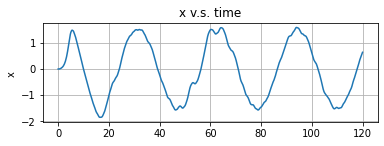

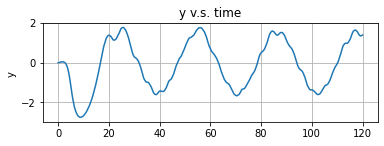

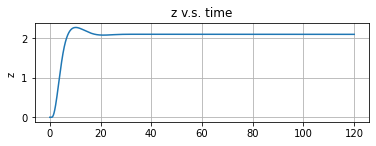

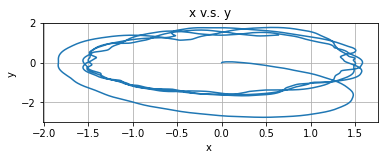

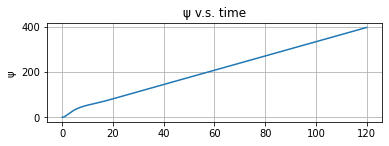

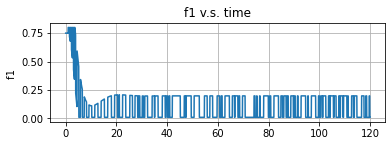

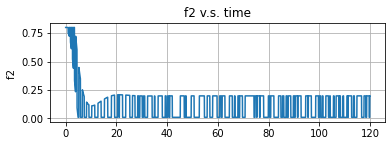

In [83]:
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("x ")
ax21.set_title('x v.s. time')
#x_position, = ax21.plot(state_log[:, 0],state_log[:, 1])
x_position, = ax21.plot(test_time, state_log[:, 0])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("y ")
ax21.set_title('y v.s. time')
x_position, = ax21.plot(test_time, state_log[:, 1])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("z ")
ax21.set_title('z v.s. time')
x_position, = ax21.plot(test_time, state_log[:, 2])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_xlabel("x ")
ax21.set_ylabel("y ")
ax21.set_title('x v.s. y')
x_position, = ax21.plot(state_log[:, 0],state_log[:, 1])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("ψ ")
ax21.set_title('ψ v.s. time')
# x_position, = ax21.plot(test_time, state_log[:, 3]% (2*pi))
x_position, = ax21.plot(test_time, state_log[:, 3])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("f1 ")
ax21.set_title('f1 v.s. time')
x_position, = ax21.plot(test_time, f_log[:, 0])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("f2 ")
ax21.set_title('f2 v.s. time')
x_position, = ax21.plot(test_time, f_log[:, 1])


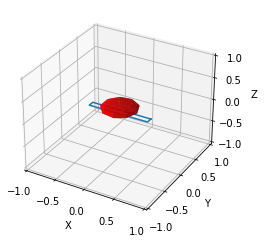

In [55]:
# sphere
def plot_globe(a,b,c,r,rotate,dense=10):
    c = c + r/3
    t1=np.linspace(0,np.pi,dense)
    t2=np.linspace(0,np.pi*2,dense)
    t1,t2=np.meshgrid(t1,t2)
    x=a+r*np.sin(t1)*np.cos(t2+rotate)
    y=b+r*np.sin(t1)*np.sin(t2+rotate)
    z=c+r*np.cos(t1)/3
    return x,y,z
# box
def box_points(w, h, z):
    points = np.zeros([5,3])
    points[0] = [ + w/2, + h/2, z]
    points[1] = [ + w/2, - h/2, z]
    points[2] = [ - w/2, - h/2, z]
    points[3] = [ - w/2, + h/2, z]
    points[4] = [ + w/2, + h/2, z]
    return points
def box_se2(x, y, z, α, ϕ, θ, ψ, u, w=1, h=.05, ax = plt.axes(projection='3d')):
    ψ = -ψ
    points = box_points(w, h, 0)
    # Rotation matrix
    R = [[cos(ψ), -sin(ψ), 0], 
         [sin(ψ), cos(ψ), 0],
         [0, 0, 1]]
    
    # Rotate
    points = [np.dot(R, p) for p in points]    
    points = array(points)

    # translate
    points[:,0] += x
    points[:,1] += y
    points[:,2] += z
    
    # propellers arrows length
    e1 = [1,0,0]    
    prop_x = array([sin(ψ), cos(ψ)])
    prop_y = array([sin(ψ), cos(ψ)])
    prop_z = array([0,0])
        
    # Plot propellers (start points)
    px = points[1:3,0] * 0.8
    py = points[1:3,1] * 0.8
    pz = points[1:3,2] * 0.8
    
    #draw blue arrows
    #ax.quiver(px, py, pz, 2*prop_x, 2*prop_y, 1*prop_z, color="blue")
    #draw blue box
    ax.plot(points[:,0],points[:,1], points[:,2])
    #draw red arrows with force
    #ax.quiver(px, py, pz, u*prop_x, u*prop_y, u*prop_z, color='r')
    
    a,b,c=plot_globe(a=x,b=y,c=z,r=0.3,rotate = ψ)
    
    ax.plot_surface(a,b,c,color="r",alpha=0.8)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_xlim3d((-1., 1.))
    ax.set_ylim3d((-1., 1.))
    ax.set_zlim3d((-1., 1.))

x, y, z, α, ϕ, θ, ψ  = 0,0,0, pi/6, 0, 0, 0.0
box_se2(x, y, z, α, ϕ, θ, ψ , [1,1], w=1, h=0.1)

#plot(x,y,z, 'o')
grid()

Animation size has reached 20983269 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


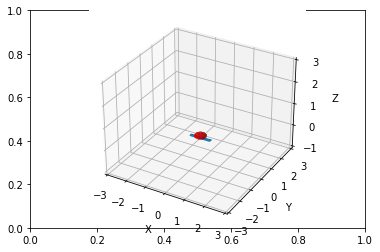

In [36]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML

fig,ax = plt.subplots()
ax = plt.axes(projection='3d')
def animate(t):
    ax.clear()       
    x, y, z, ψ, dx, dy, dz, dψ = state_log[t][0:9]
    
    u = f_log[t]
    #a_lift = 0.5 * sin(α) * (abs(u[0]) + abs(u[1])) - g
    # box points
    box = box_se2(x, y, z, α, ϕ, θ, ψ, u, w=1, h=0.1, ax=ax)
    #plt.plot(state_log[0],state_log[1],state_log[2], 'b')
    # Initial conditions
    #ax.plot(t, x_log[t,0],  'bo')
    ax.set_xlim((-3, 3))
    ax.set_ylim((-3, 3))
    ax.set_zlim((-1, 3))

anim = animation.FuncAnimation(fig, animate, frames=len(test_time), interval=60)
anim.save('S_blimp.gif',writer = 'pillow')
HTML(anim.to_jshtml())